In [23]:
import numpy as np
import pandas as pd
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import spikeinterface as si
import matplotlib.pyplot as plt
import os
from matplotlib.backends.backend_pdf import PdfPages

from tqdm import tqdm


import sys
import spikeinterface as si
import matplotlib.pyplot as plt
import spikeinterface.extractors as se
import spikeinterface.preprocessing as spre
import spikeinterface.sorters as ss
import spikeinterface.widgets as sw
import spikeinterface.qualitymetrics as sqm
import json
import probeinterface

from probeinterface import Probe, ProbeGroup
from probeinterface.plotting import plot_probe, plot_probegroup
from probeinterface import generate_dummy_probe, generate_linear_probe
from probeinterface import write_probeinterface, read_probeinterface
from probeinterface import write_prb, read_prb
from torch.nn.functional import max_pool1d


import torch
import torch.nn as nn
import torch.nn.functional as F


from function.Function import *


In [3]:
channel_indices = {
        "1": [1, 3, 5, 7, 9, 11],
        "2": [13, 15, 17, 19, 21, 23],
        "3": [24, 25, 26, 27, 28, 29],
        "4": [12, 14, 16, 18, 20, 22],
        "5": [0, 2, 4, 6, 8, 10]
        }
channel_position = {
    0: [650, 0],
    2: [650, 50],
    4: [650, 100],
    6: [600, 100],
    8: [600, 50],
    10: [600, 0],
    1: [0, 0],
    3: [0, 50],
    5: [0, 100],
    7: [50, 100],
    9: [50, 50],
    11: [50, 0],
    13: [150, 200], 
    15: [150, 250],
    17: [150, 300],
    19: [200, 300],
    21: [200, 250],
    23: [200, 200],
    12: [500, 200],
    14: [500, 250],
    16: [500, 300],
    18: [450, 300],
    20: [450, 250],
    22: [450, 200],
    24: [350, 400],
    26: [350, 450],
    28: [350, 500],
    25: [300, 400],
    27: [300, 450],
    29: [300, 500]}

In [4]:
recording_raw = se.read_blackrock(file_path='/media/ubuntu/sda/data/mouse6/ns4/natural_image/mouse6_021322_natural_image001.ns4')
recording_recorded = recording_raw.remove_channels(["98", '31', '32'])
recording_stimulated = recording_raw.channel_slice(['98'])

recording_f = spre.bandpass_filter(recording_recorded, freq_min=300, freq_max=3000)
recording_f = spre.common_reference(recording_f, reference="global", operator="median")

In [5]:
data = recording_f.get_traces().astype("float32").T

In [13]:
threshold_result = detect_local_maxima_in_window(data)


In [14]:
threshold_result = np.array(threshold_result)
valid_indices = threshold_result[(threshold_result > 30)]
valid_indices = valid_indices[valid_indices < data.shape[1] - 31]

In [15]:
spike_inf = pd.read_csv("/home/ubuntu/Documents/jct/project/code/Spike_Sorting/sorting_results/021322/spike_inf.csv")

In [16]:
removed_spikes = spike_inf['cluster'].value_counts()
removed_spikes = removed_spikes[removed_spikes < 8000].index

In [17]:
spike_inf = spike_inf[~spike_inf['cluster'].isin(removed_spikes)]

In [18]:
labels = label_array1_based_on_array2(valid_indices, spike_inf['time'], threshold=1)

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset, random_split
from torch.utils.data import Subset


class CustomDataset(Dataset):
    def __init__(self, data, labels):
        self.data = data
        self.labels = labels

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        return self.data[idx], self.labels[idx]
    

labels = np.array(labels) 
indices_0 = np.where(labels == 0)[0] 
indices_1 = np.where(labels == 1)[0] 

target_0_count = len(indices_1) * 2  

if len(indices_0) > target_0_count:
    sampled_indices_0 = np.random.choice(indices_0, target_0_count, replace=False)
else:
    sampled_indices_0 = indices_0  

final_indices = np.concatenate([sampled_indices_0, indices_1])

np.random.shuffle(final_indices)


sampled_data = extract_windows(data, valid_indices[final_indices], window_size=61)
sampled_labels = labels[final_indices]


dataset = CustomDataset(sampled_data, sampled_labels)

train_size = int(0.8 * len(dataset))
test_size = len(dataset) - train_size
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])

batch_size = 1024 
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

class MLP(nn.Module):
    def __init__(self, input_size, hidden_size1, hidden_size2, output_size):
        super(MLP, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size1)
        self.relu1 = nn.ReLU()
        self.fc2 = nn.Linear(hidden_size1, hidden_size2)
        self.relu2 = nn.ReLU()
        self.fc3 = nn.Linear(hidden_size2, output_size)
        self.sigmoid = nn.Sigmoid()  

    def forward(self, x):
        x = x.reshape(-1, 61 * 30)
        x = self.fc1(x)
        x = self.relu1(x)
        x = self.fc2(x)
        x = self.relu2(x)
        x = self.fc3(x)
        x = self.sigmoid(x)
        return x

In [19]:
input_size = 30 * 61
hidden_size1 = 128
hidden_size2 = 32
output_size = 1  
device = 'cuda'
model = MLP(input_size, hidden_size1, hidden_size2, output_size)
model = model.to(device)

criterion = nn.BCELoss()  
optimizer = optim.Adam(model.parameters(), lr=0.0001)

In [20]:
num_epochs = 30
for epoch in range(num_epochs):
    model.train()
    total_loss = 0
    for batch_data, batch_labels in train_loader:
        batch_labels = batch_labels.float().unsqueeze(1)

        batch_data = batch_data.to(device)
        batch_labels = batch_labels.to(device)

        outputs = model(batch_data)
        loss = criterion(outputs, batch_labels)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {total_loss/len(train_loader):.4f}")

    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for batch_data, batch_labels in test_loader:
            batch_labels = batch_labels.float().unsqueeze(1)
            batch_data = batch_data.to(device)
            batch_labels = batch_labels.to(device)

            outputs = model(batch_data)
            predicted = (outputs > 2).float()  
            total += batch_labels.size(0)
            correct += (predicted == batch_labels).sum().item()

    print(f"Test Accuracy: {100 * correct / total:.2f}%")

Epoch [1/30], Loss: 0.3903
Test Accuracy: 66.69%
Epoch [2/30], Loss: 0.2923
Test Accuracy: 66.69%
Epoch [3/30], Loss: 0.2618
Test Accuracy: 66.69%
Epoch [4/30], Loss: 0.2444
Test Accuracy: 66.69%
Epoch [5/30], Loss: 0.2323
Test Accuracy: 66.69%
Epoch [6/30], Loss: 0.2233
Test Accuracy: 66.69%
Epoch [7/30], Loss: 0.2163
Test Accuracy: 66.69%
Epoch [8/30], Loss: 0.2107
Test Accuracy: 66.69%
Epoch [9/30], Loss: 0.2061
Test Accuracy: 66.69%
Epoch [10/30], Loss: 0.2021
Test Accuracy: 66.69%
Epoch [11/30], Loss: 0.1986
Test Accuracy: 66.69%
Epoch [12/30], Loss: 0.1957
Test Accuracy: 66.69%
Epoch [13/30], Loss: 0.1929
Test Accuracy: 66.69%
Epoch [14/30], Loss: 0.1907
Test Accuracy: 66.69%
Epoch [15/30], Loss: 0.1886
Test Accuracy: 66.69%
Epoch [16/30], Loss: 0.1868
Test Accuracy: 66.69%
Epoch [17/30], Loss: 0.1850
Test Accuracy: 66.69%
Epoch [18/30], Loss: 0.1835
Test Accuracy: 66.69%
Epoch [19/30], Loss: 0.1822
Test Accuracy: 66.69%
Epoch [20/30], Loss: 0.1809
Test Accuracy: 66.69%
Epoch [21

In [21]:
model = torch.load("/home/ubuntu/Documents/jct/project/code/Spike_Sorting/ANN_result/spike_detection.pth")
model = model.to('cuda')


In [23]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import umap
import random
device = 'cuda'
num_samples = 100000
indices = random.sample(range(len(sampled_data)), num_samples)
sampled_data_subset = sampled_data[indices]
sampled_labels_subset = sampled_labels[indices].astype(str)

model.eval()

data_input = torch.tensor(sampled_data_subset, dtype=torch.float32).to(device) 
with torch.no_grad():
    outputs = model(data_input)  
    predicted_labels = (outputs > 0.7).float()  

    data_input = torch.tensor(sampled_data_subset, dtype=torch.float32).view(num_samples, -1).to(device) 

    intermediate_output = model.fc2(model.relu1(model.fc1(data_input))) 

pca = PCA(n_components=20)
pca_data = pca.fit_transform(intermediate_output.cpu().numpy())

umap_reducer = umap.UMAP(n_components=2, random_state=42)
umap_data = umap_reducer.fit_transform(pca_data)


In [24]:
label_df = pd.DataFrame([sampled_labels_subset, np.concatenate(predicted_labels.cpu().numpy()).astype(int).astype(str)], index=  ['gt', 'predicted']).T
label_df['diff'] = None

label_df['diff'] = label_df.apply(lambda x: "1" if x['gt'] != x['predicted'] else "0", axis=1)

In [34]:
from matplotlib.backends.backend_pdf import PdfPages

color_map = {
    '0': plt.cm.tab10(0),
    '1': plt.cm.tab10(1)
}  
with PdfPages('figure/umap_spike_detect_train.pdf') as pdf:
    unique_labels = np.unique(sampled_labels_subset)  

    colors = [color_map[label] for label in sampled_labels_subset]  
    plt.figure(figsize=(8, 8))
    scatter = plt.scatter(umap_data[:, 0], umap_data[:, 1], c=colors, s=0.1, alpha=0.7)
    plt.title('Ground Truth Labels')
    plt.xticks([])
    plt.yticks([])

    pdf.savefig()
    plt.close()

    unique_labels = np.unique(predicted_labels.cpu().numpy()).astype(str)  

    colors = [color_map[label] for label in np.concatenate(predicted_labels.cpu().numpy()).astype(int).astype(str)]  
    plt.figure(figsize=(8, 8))
    scatter = plt.scatter(umap_data[:, 0], umap_data[:, 1], c=colors, s=0.1, alpha=0.7)
    plt.title('Predicted Labels')
    plt.xticks([])
    plt.yticks([])

    pdf.savefig()
    plt.close()


In [50]:
torch.save(model, 'ANN_result/spike_detection.pth')

- spike alignment

- spike classification

In [16]:
unique_clusters = np.unique(spike_inf['cluster'])
cluster_to_index = {cluster: idx for idx, cluster in enumerate(unique_clusters)}
spike_inf['cluster'] = np.array([cluster_to_index[cluster] for cluster in spike_inf['cluster']])


In [19]:
spike_inf = spike_inf[spike_inf['time'] < data.shape[1] - 31]

In [74]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset, random_split
from torch.utils.data import Subset


class CustomDataset(Dataset):
    def __init__(self, data, labels):
        self.data = data
        self.labels = labels

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        return self.data[idx], self.labels[idx]
indices = spike_inf['time'].values

labels = spike_inf['cluster'].values

window_view_classify = extract_windows(data, indices, window_size=61)

balanced_indices = []
for cluster in spike_inf['cluster'].unique():
    cluster_indices = np.where(labels == cluster)[0]
    if len(cluster_indices) > 8000:
        sampled_indices = np.random.choice(cluster_indices, 8000, replace=False)
    else:
        sampled_indices = cluster_indices
    balanced_indices.extend(sampled_indices)

np.random.shuffle(balanced_indices)

balanced_data = window_view_classify[balanced_indices]
balanced_labels = labels[balanced_indices]

dataset = CustomDataset(balanced_data, balanced_labels)

train_size = int(0.8 * len(dataset))
test_size = len(dataset) - train_size
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])

batch_size = 1024
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [76]:
class MLP(nn.Module):
    def __init__(self, input_size, hidden_size1, hidden_size2, num_classes):
        super(MLP, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size1)
        self.relu1 = nn.ReLU()
        self.fc2 = nn.Linear(hidden_size1, hidden_size2)
        self.relu2 = nn.ReLU()
        self.fc3 = nn.Linear(hidden_size2, num_classes)  # 输出类别数

    def forward(self, x):
        x = x.reshape(-1, 61 * 30)
        x = self.fc1(x)
        x = self.relu1(x)
        x = self.fc2(x)
        x = self.relu2(x)
        x = self.fc3(x)  
        return x

device = 'cuda'
input_size = balanced_data.shape[1] * balanced_data.shape[2]
hidden_size1 = 64
hidden_size2 = 50
num_classes = 41
model = MLP(input_size, hidden_size1, hidden_size2, num_classes)
model = model.to(device)

criterion = nn.CrossEntropyLoss()  
optimizer = optim.Adam(model.parameters(), lr=0.00001)

In [23]:
from sklearn.metrics import accuracy_score, classification_report


num_epochs = 180
for epoch in range(num_epochs):
    all_labels = []
    all_predictions = []
    model.train()
    total_loss = 0
    for batch_data, batch_labels in train_loader:
        batch_data = batch_data.to(device)
        batch_labels = batch_labels.to(device)

        outputs = model(batch_data)
        predicted = torch.argmax(outputs, dim=1)  

        loss = criterion(outputs, batch_labels)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

        all_labels.extend(batch_labels.cpu().numpy())
        all_predictions.extend(predicted.cpu().numpy())

    accuracy = accuracy_score(all_labels, all_predictions)
    print(f"Train Accuracy: {accuracy * 100:.2f}%")
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {total_loss/len(train_loader):.4f}")

    model.eval()
    all_labels = []
    all_predictions = []
    with torch.no_grad():
        for batch_data, batch_labels in test_loader:
            batch_data = batch_data.to(device)
            batch_labels = batch_labels.to(device)

            outputs = model(batch_data)
            predicted = torch.argmax(outputs, dim=1)  

            all_labels.extend(batch_labels.cpu().numpy())
            all_predictions.extend(predicted.cpu().numpy())

    all_labels = np.array(all_labels)
    all_predictions = np.array(all_predictions)

    accuracy = accuracy_score(all_labels, all_predictions)
    print(f"Test Accuracy: {accuracy * 100:.2f}%")


Train Accuracy: 4.22%
Epoch [1/180], Loss: 9.0120
Test Accuracy: 6.04%
Train Accuracy: 8.18%
Epoch [2/180], Loss: 5.8288
Test Accuracy: 10.47%
Train Accuracy: 13.02%
Epoch [3/180], Loss: 4.4330
Test Accuracy: 15.63%
Train Accuracy: 18.85%
Epoch [4/180], Loss: 3.6389
Test Accuracy: 21.66%
Train Accuracy: 25.31%
Epoch [5/180], Loss: 3.1114
Test Accuracy: 27.90%
Train Accuracy: 31.67%
Epoch [6/180], Loss: 2.7206
Test Accuracy: 34.08%
Train Accuracy: 37.95%
Epoch [7/180], Loss: 2.4042
Test Accuracy: 40.10%
Train Accuracy: 43.98%
Epoch [8/180], Loss: 2.1368
Test Accuracy: 45.74%
Train Accuracy: 49.68%
Epoch [9/180], Loss: 1.9051
Test Accuracy: 50.95%
Train Accuracy: 54.79%
Epoch [10/180], Loss: 1.7049
Test Accuracy: 55.59%
Train Accuracy: 59.25%
Epoch [11/180], Loss: 1.5336
Test Accuracy: 59.61%
Train Accuracy: 63.07%
Epoch [12/180], Loss: 1.3861
Test Accuracy: 63.11%
Train Accuracy: 66.38%
Epoch [13/180], Loss: 1.2606
Test Accuracy: 66.06%
Train Accuracy: 69.27%
Epoch [14/180], Loss: 1.153

In [81]:
model = torch.load("/home/ubuntu/Documents/jct/project/code/Spike_Sorting/ANN_result/spike_classification.pth")

In [82]:
model.eval()
all_labels = []
all_predictions = []
latent_value = []

with torch.no_grad():
    for batch_data, batch_labels in test_loader:
        batch_data = batch_data.to(device)
        batch_labels = batch_labels.to(device)

        outputs = model(batch_data)
        predicted = torch.argmax(outputs, dim=1)  

        batch_data = batch_data.reshape(-1, 61 * 30)
        batch_data = model.fc1(batch_data)
        batch_data = model.relu1(batch_data)
        batch_data = model.fc2(batch_data)
        batch_data = model.relu2(batch_data)
        latent_value.append(batch_data.cpu())  

        all_labels.extend(batch_labels.cpu().numpy())
        all_predictions.extend(predicted.cpu().numpy())

all_labels = np.array(all_labels)
all_predictions = np.array(all_predictions)
latent_value = torch.cat(latent_value, dim=0).numpy()


In [83]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import umap
import random

pca = PCA(n_components=20)
pca_data = pca.fit_transform(latent_value)

umap_reducer = umap.UMAP(n_components=2, random_state=42)
umap_data = umap_reducer.fit_transform(pca_data)

Text(0, 0.5, 'UMAP 2')

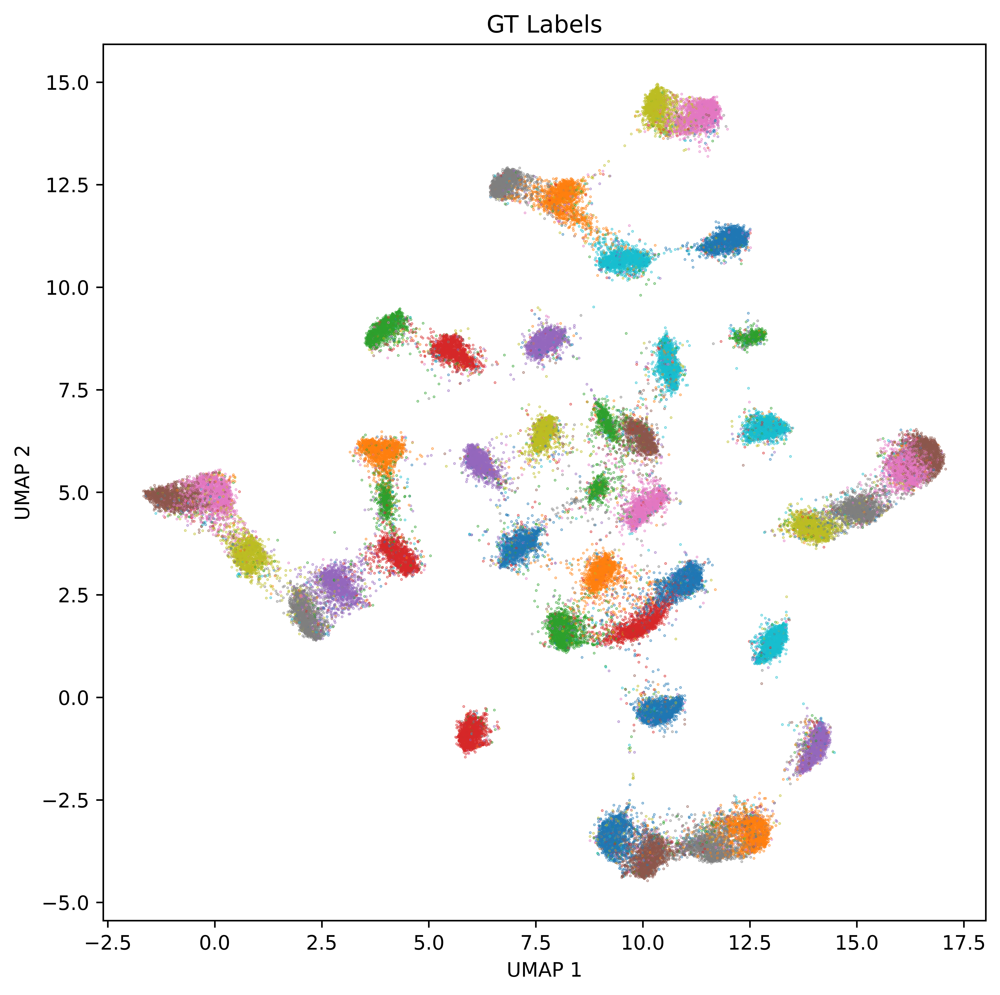

In [86]:
unique_dates = np.unique(all_labels)
color_map = {date: plt.cm.tab10(i % 10) for i, date in enumerate(unique_dates)} 

colors = [color_map[date] for date in all_labels]

plt.figure(figsize=(8, 8), dpi=1000)
scatter = plt.scatter(umap_data[:, 0], umap_data[:, 1], c=colors, s=0.1, alpha=0.7)
plt.title('GT Labels')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')

Text(0, 0.5, 'UMAP 2')

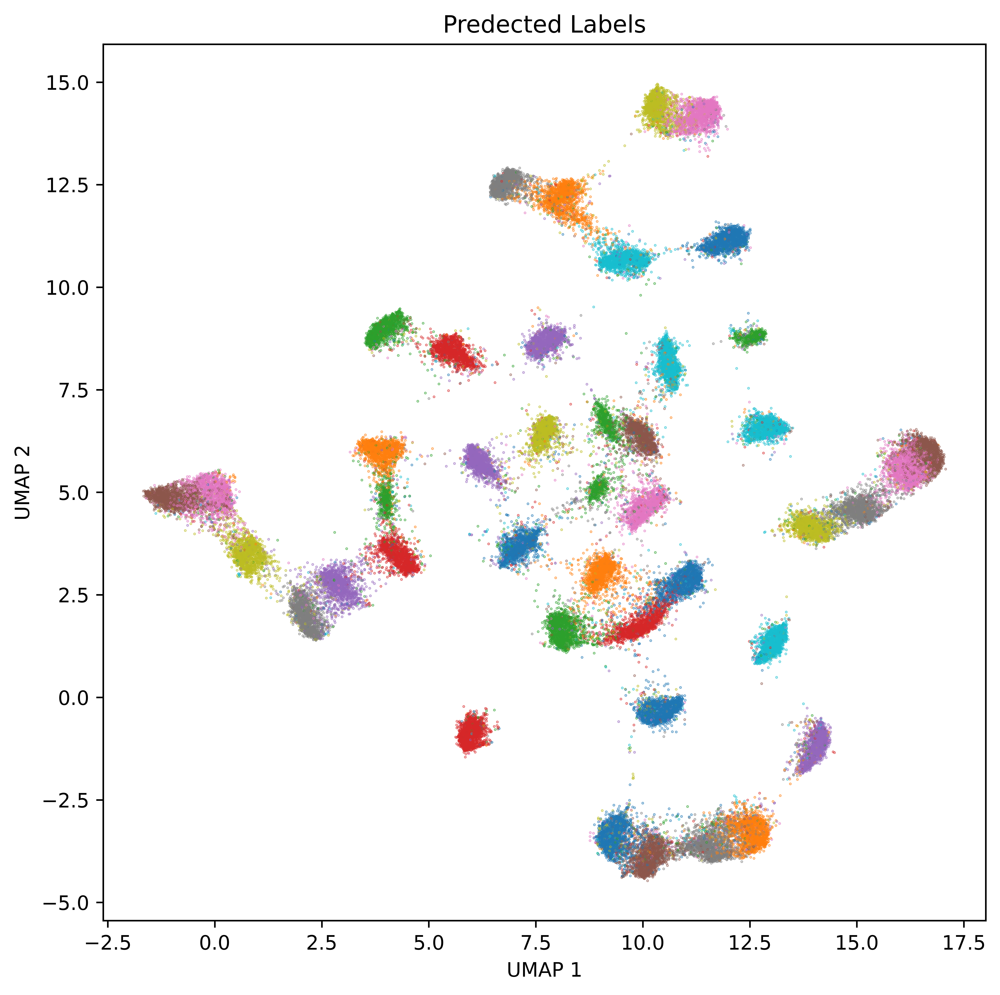

In [87]:
unique_dates = np.unique(all_predictions)
color_map = {date: plt.cm.tab10(i % 10) for i, date in enumerate(unique_dates)} 

colors = [color_map[date] for date in all_predictions]

plt.figure(figsize=(8, 8), dpi=1000)
scatter = plt.scatter(umap_data[:, 0], umap_data[:, 1], c=colors, s=0.1, alpha=0.7)
plt.title('Predected Labels')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')

In [51]:
torch.save(model, 'ANN_result/spike_classification.pth')

- compare

In [52]:
recording_raw = se.read_blackrock(file_path='/media/ubuntu/sda/data/mouse6/ns4/natural_image/mouse6_022522_natural_image_001.ns4')
recording_recorded = recording_raw.remove_channels(['98', '31', '32'])
recording_stimulated = recording_raw.channel_slice(['98'])

recording_f_22522 = spre.bandpass_filter(recording_recorded, freq_min=300, freq_max=3000)
recording_f_22522 = spre.common_reference(recording_f_22522, reference="global", operator="median")

In [53]:
data_22522 = recording_f_22522.get_traces().astype("float32").T

In [54]:
threshold_result_22522 = detect_local_maxima_in_window(data_22522)
threshold_result_22522 = np.array(threshold_result_22522)
valid_indices_22522 = threshold_result_22522[(threshold_result_22522 > 30)]
valid_indices_22522 = valid_indices_22522[valid_indices_22522 < data_22522.shape[1] - 31]

In [55]:
spike_inf_22522 = pd.read_csv("/home/ubuntu/Documents/jct/project/code/Spike_Sorting/sorting_results/022522/spike_inf.csv")

In [87]:
labels_22522 = label_array1_based_on_array2(valid_indices_22522, spike_inf_22522['time'].values, threshold=1)

In [137]:
cluster_labels_22522 = cluster_label_array1_based_on_array2(valid_indices_22522, spike_inf_22522, threshold=1)

In [57]:
sampled_data_22522 = extract_windows(data_22522, valid_indices_22522, window_size=61)

In [ ]:
# num_samples = 100000
# indices_22522 = random.sample(range(len(sampled_data_22522)), num_samples)
# sampled_data_subset_22522 = sampled_data_22522[indices_22522]
# sampled_labels_subset_22522 = labels_22522[indices_22522].astype(str)

# model.eval()

# data_input_22522 = torch.tensor(sampled_data_subset_22522, dtype=torch.float32).to(device) 
# with torch.no_grad():
#     outputs_22522 = model(data_input_22522)  
#     predicted_labels_22522 = (outputs > 0.5).float()  

#     data_input_22522 = torch.tensor(sampled_data_subset_22522, dtype=torch.float32).view(num_samples, -1).to(device) 

#     intermediate_output_22522 = model.fc2(model.relu1(model.fc1(data_input_22522))) 

# pca_22522 = PCA(n_components=20)
# pca_data_22522 = pca_22522.fit_transform(intermediate_output_22522.cpu().numpy())

# umap_reducer_22522 = umap.UMAP(n_components=2, random_state=42)
# umap_data_22522 = umap_reducer_22522.fit_transform(pca_data_22522)

In [ ]:
# label_df = pd.DataFrame([sampled_labels_subset_22522, np.concatenate(predicted_labels_22522.cpu().numpy()).astype(int).astype(str)], index=  ['gt', 'predicted']).T
# label_df['diff'] = None

# label_df['diff'] = label_df.apply(lambda x: "1" if x['gt'] != x['predicted'] else "0", axis=1)

In [ ]:
# color_map = {
#     '0': 'gray',
#     '1': 'orange'
# }  
# with PdfPages('figure/umap_spike_detect_compare.pdf') as pdf:
#     unique_labels = np.unique(sampled_labels_subset_22522)  

#     colors = [color_map[label] for label in sampled_labels_subset_22522]  
#     plt.figure(figsize=(10, 8))
#     scatter = plt.scatter(umap_data_22522[:, 0], umap_data_22522[:, 1], c=colors, s=0.1, alpha=0.7)
#     plt.title('Ground Truth Labels')
#     plt.xlabel('UMAP 1')
#     plt.ylabel('UMAP 2')

#     for label, color in color_map.items():
#         plt.scatter([], [], c=color, label=label,) 
#     plt.legend(title='Labels', loc='best')

#     pdf.savefig()
#     plt.close()

#     unique_labels = np.unique(predicted_labels_22522.cpu().numpy()).astype(str)  

#     colors = [color_map[label] for label in np.concatenate(predicted_labels_22522.cpu().numpy()).astype(int).astype(str)]  
#     plt.figure(figsize=(10, 8))
#     scatter = plt.scatter(umap_data_22522[:, 0], umap_data_22522[:, 1], c=colors, s=0.1, alpha=0.7)
#     plt.title('Predicted Labels')
#     plt.xlabel('UMAP 1')
#     plt.ylabel('UMAP 2')

#     for label, color in color_map.items():
#         plt.scatter([], [], c=color, label=label,) 
#     plt.legend(title='Labels', loc='best')

#     pdf.savefig()
#     plt.close()

#     unique_labels = np.unique(predicted_labels_22522.cpu().numpy()).astype(str)  

#     colors = [color_map[label] for label in label_df['diff']]  
#     plt.figure(figsize=(10, 8))
#     scatter = plt.scatter(umap_data_22522[:, 0], umap_data_22522[:, 1], c=colors, s=0.1, alpha=0.7)
#     plt.title('Predicted Labels')
#     plt.xlabel('UMAP 1')
#     plt.ylabel('UMAP 2')

#     for label, color in color_map.items():
#         plt.scatter([], [], c=color, label=label,) 
#     plt.legend(title='Labels', loc='best')

#     pdf.savefig()
#     plt.close()

In [ ]:
# len(label_df[label_df['diff'] == "0"])/len(label_df)

In [ ]:
# import torch
# import torch.nn as nn
# import torch.optim as optim
# from torch.utils.data import DataLoader, Dataset, random_split
# from torch.utils.data import Subset
# class CustomDataset(Dataset):
#     def __init__(self, data, labels):
#         self.data = data
#         self.labels = labels

#     def __len__(self):
#         return len(self.data)

#     def __getitem__(self, idx):
#         return self.data[idx], self.labels[idx]
    

# labels = np.array(labels) 
# indices_0 = np.where(labels == 0)[0] 
# indices_1 = np.where(labels == 1)[0] 

# target_0_count = len(indices_1) * 2  

# if len(indices_0) > target_0_count:
#     sampled_indices_0 = np.random.choice(indices_0, target_0_count, replace=False)
# else:
#     sampled_indices_0 = indices_0  

# final_indices = np.concatenate([sampled_indices_0, indices_1])

# np.random.shuffle(final_indices)


# sampled_data = extract_windows(data, valid_indices[final_indices], window_size=61)
# sampled_labels = labels[final_indices]




In [58]:
spike_detection_model = torch.load('ANN_result/spike_detection.pth')
spike_classification_model = torch.load('ANN_result/spike_classification.pth')

In [174]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset, random_split
from torch.utils.data import Subset
class CustomDataset(Dataset):
    def __init__(self, data, labels):
        self.data = data
        self.labels = labels

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        return self.data[idx], self.labels[idx]
    
test_dataset = CustomDataset(sampled_data_22522, labels_22522)

batch_size = 1024 
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

class MLP(nn.Module):
    def __init__(self, input_size, hidden_size1, hidden_size2, output_size):
        super(MLP, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size1)
        self.relu1 = nn.ReLU()
        self.fc2 = nn.Linear(hidden_size1, hidden_size2)
        self.relu2 = nn.ReLU()
        self.fc3 = nn.Linear(hidden_size2, output_size)
        self.sigmoid = nn.Sigmoid()  

    def forward(self, x):
        x = x.reshape(-1, 61 * 30)
        x = self.fc1(x)
        x = self.relu1(x)
        x = self.fc2(x)
        x = self.relu2(x)
        x = self.fc3(x)
        x = self.sigmoid(x)
        return x

In [212]:
spike_detection_model = spike_detection_model.to(device)
spike_detection_model.eval()

all_labels = []
predicted_labels = []
latent_value = []

with torch.no_grad():
    for batch_data, batch_labels in test_loader:
        batch_labels = batch_labels.float().unsqueeze(1)
        batch_data = batch_data.to(device)
        batch_labels = batch_labels.to(device)

        outputs = spike_detection_model(batch_data)
        predicted = (outputs > 4).float()  

        batch_data = batch_data.reshape(-1, 61 * 30)
        batch_data = spike_detection_model.fc1(batch_data)
        batch_data = spike_detection_model.relu1(batch_data)
        batch_data = spike_detection_model.fc2(batch_data)
        batch_data = spike_detection_model.relu2(batch_data)
        latent_value.append(batch_data.cpu())  
        
        all_labels.extend(batch_labels.cpu().numpy())
        predicted_labels.extend(predicted.cpu().numpy())

all_labels = np.array(all_labels)
predicted_labels = np.array(predicted_labels)
latent_value = torch.cat(latent_value, dim=0).numpy()

In [214]:
num_samples = 100000
indices = random.sample(range(len(latent_value)), num_samples)
latent_value_subset = latent_value[indices, :]
all_labels_subset = np.concatenate(all_labels[indices]).astype(int).astype(str)
all_predictions_subset = np.concatenate(predicted_labels[indices]).astype(int).astype(str)


In [215]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import umap
import random

pca = PCA(n_components=20)
pca_data = pca.fit_transform(latent_value_subset)

umap_reducer = umap.UMAP(n_components=2, random_state=42)
umap_data = umap_reducer.fit_transform(pca_data)

Text(0, 0.5, 'UMAP 2')

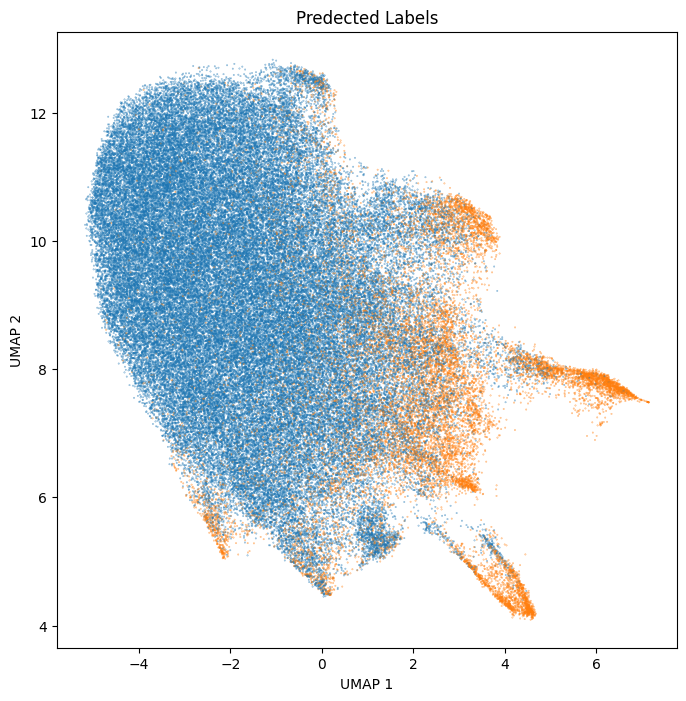

In [216]:
unique_dates = np.unique(all_labels_subset)
color_map = {date: plt.cm.tab10(i % 10) for i, date in enumerate(unique_dates)} 

colors = [color_map[date] for date in all_labels_subset]

plt.figure(figsize=(8, 8))
scatter = plt.scatter(umap_data[:, 0], umap_data[:, 1], c=colors, s=0.1, alpha=0.7)
plt.title('Predected Labels')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')

Text(0, 0.5, 'UMAP 2')

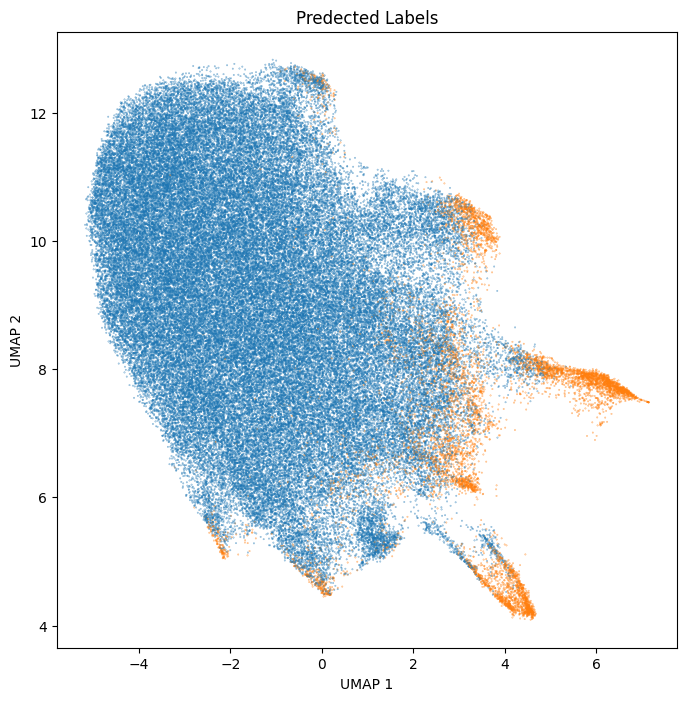

In [217]:
unique_dates = np.unique(all_predictions_subset)
color_map = {date: plt.cm.tab10(i % 10) for i, date in enumerate(unique_dates)} 

colors = [color_map[date] for date in all_predictions_subset]

plt.figure(figsize=(8, 8))
scatter = plt.scatter(umap_data[:, 0], umap_data[:, 1], c=colors, s=0.1, alpha=0.7)
plt.title('Predected Labels')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')

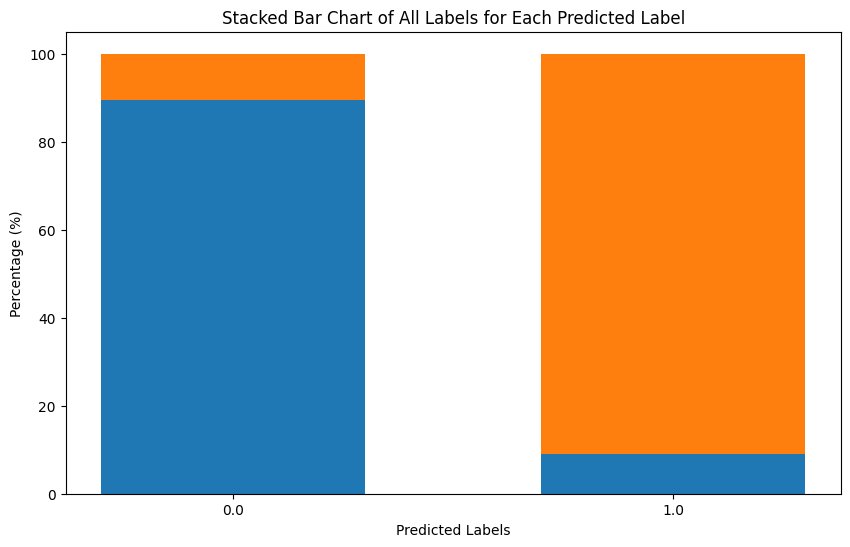

In [218]:
import numpy as np
import matplotlib.pyplot as plt
#all_labels = np.concatenate(all_labels).astype(int).astype(str)
unique_predicted = np.unique(predicted_labels)
unique_all = np.unique(all_labels)

percentages = []
for pred_class in unique_predicted:
    # 获取当前 predicted_labels 类别的索引
    indices = np.where(predicted_labels == pred_class)[0]
    # 获取对应的 all_labels
    corresponding_labels = all_labels[indices]
    # 统计 all_labels 的分布
    counts = np.array([np.sum(corresponding_labels == label) for label in unique_all])
    # 计算百分比
    percentages.append(counts / counts.sum() * 100)

percentages = np.array(percentages).T  # 转置为 (all_labels 类别数, predicted_labels 类别数)

# 绘制堆叠柱状图
x = np.arange(len(unique_predicted))  # predicted_labels 类别的索引
width = 0.6  # 柱的宽度

plt.figure(figsize=(10, 6))
bottom = np.zeros(len(unique_predicted))  # 初始化堆叠的底部
for i, label in enumerate(unique_all):
    plt.bar(x, percentages[i], width, bottom=bottom, label=f'All Label {label}')
    bottom += percentages[i]  # 更新底部位置

plt.xlabel('Predicted Labels')
plt.ylabel('Percentage (%)')
plt.title('Stacked Bar Chart of All Labels for Each Predicted Label')
plt.xticks(x, unique_predicted)  # 设置 x 轴刻度
plt.show()

In [219]:
spike_indices = valid_indices_22522[np.where(predicted_labels == 1)[0]]
spike_sampled_data = sampled_data_22522[np.where(predicted_labels == 1)[0], :]
spike_cluster_label = cluster_labels_22522[np.where(predicted_labels == 1)[0]]

In [220]:
test_dataset = CustomDataset(spike_sampled_data, spike_cluster_label)

batch_size = 1024 
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

class MLP(nn.Module):
    def __init__(self, input_size, hidden_size1, hidden_size2, output_size):
        super(MLP, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size1)
        self.relu1 = nn.ReLU()
        self.fc2 = nn.Linear(hidden_size1, hidden_size2)
        self.relu2 = nn.ReLU()
        self.fc3 = nn.Linear(hidden_size2, output_size)
        self.sigmoid = nn.Sigmoid()  

    def forward(self, x):
        x = x.reshape(-1, 61 * 30)
        x = self.fc1(x)
        x = self.relu1(x)
        x = self.fc2(x)
        x = self.relu2(x)
        x = self.fc3(x)
        return x

In [221]:
spike_classification_model = spike_classification_model.to(device)
spike_classification_model.eval()

all_labels = []
predicted_labels = []
latent_value = []

with torch.no_grad():
    for batch_data, batch_labels in test_loader:
        batch_labels = batch_labels.float().unsqueeze(1)
        batch_data = batch_data.to(device)
        batch_labels = batch_labels.to(device)

        outputs = spike_classification_model(batch_data)
        predicted = torch.argmax(outputs, dim=1)  

        batch_data = batch_data.reshape(-1, 61 * 30)
        batch_data = spike_classification_model.fc1(batch_data)
        batch_data = spike_classification_model.relu1(batch_data)
        batch_data = spike_classification_model.fc2(batch_data)
        batch_data = spike_classification_model.relu2(batch_data)
        latent_value.append(batch_data.cpu())  
        
        all_labels.extend(batch_labels.cpu().numpy())
        predicted_labels.extend(predicted.cpu().numpy())

all_labels = np.array(all_labels)
predicted_labels = np.array(predicted_labels)
latent_value = torch.cat(latent_value, dim=0).numpy()

In [222]:
num_samples = 100000
indices = random.sample(range(len(latent_value)), num_samples)
latent_value_subset = latent_value[indices, :]
all_labels_subset = np.concatenate(all_labels[indices]).astype(int).astype(str)
all_predictions_subset = predicted_labels[indices].astype(int).astype(str)

In [223]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import umap
import random

pca = PCA(n_components=20)
pca_data = pca.fit_transform(latent_value_subset)

umap_reducer = umap.UMAP(n_components=2, random_state=42, n_neighbors= 5, min_dist=0)
umap_data = umap_reducer.fit_transform(pca_data)

Text(0, 0.5, 'UMAP 2')

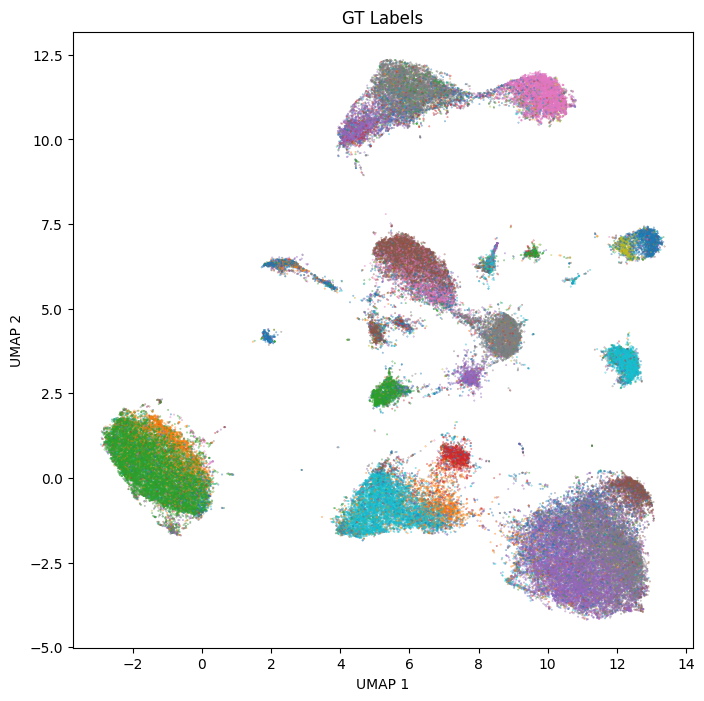

In [224]:
unique_dates = np.unique(all_labels_subset)
color_map = {date: plt.cm.tab10(i % 10) for i, date in enumerate(unique_dates)} 

colors = [color_map[date] for date in all_labels_subset]

plt.figure(figsize=(8, 8))
scatter = plt.scatter(umap_data[:, 0], umap_data[:, 1], c=colors, s=0.1, alpha=0.7)
plt.title('GT Labels')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')

Text(0, 0.5, 'UMAP 2')

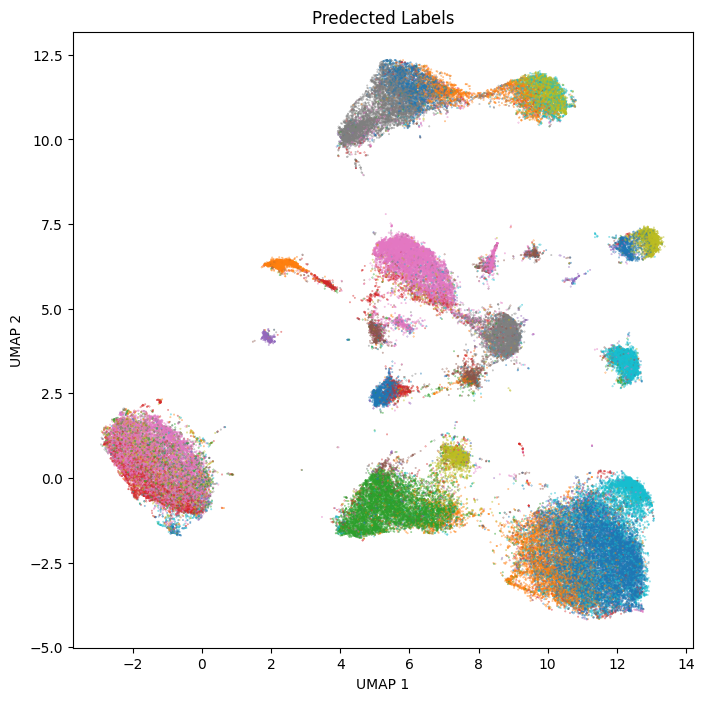

In [225]:
unique_dates = np.unique(all_predictions_subset)
color_map = {date: plt.cm.tab10(i % 10) for i, date in enumerate(unique_dates)} 

colors = [color_map[date] for date in all_predictions_subset]

plt.figure(figsize=(8, 8))
scatter = plt.scatter(umap_data[:, 0], umap_data[:, 1], c=colors, s=0.1, alpha=0.7)
plt.title('Predected Labels')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')

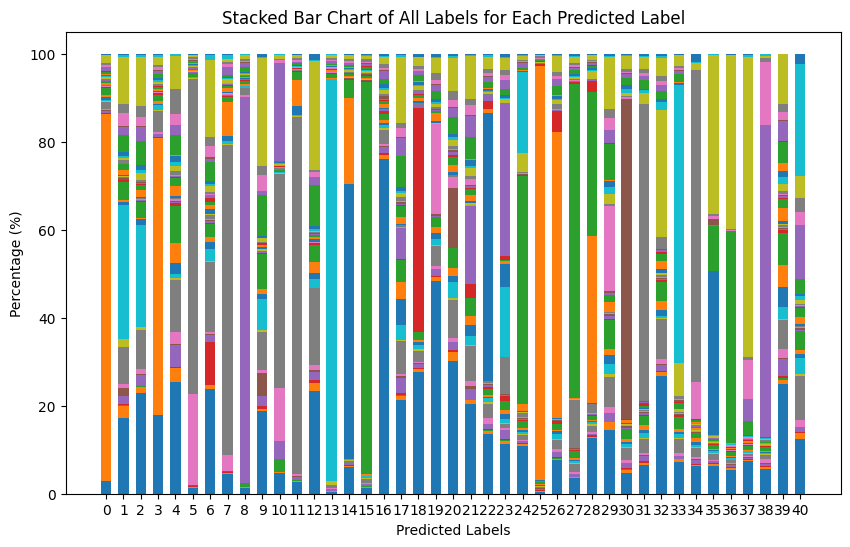

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
#all_labels = np.concatenate(all_labels).astype(int).astype(str)
unique_predicted = np.unique(predicted_labels)
unique_all = np.unique(all_labels)

percentages = []
for pred_class in unique_predicted:
    # 获取当前 predicted_labels 类别的索引
    indices = np.where(predicted_labels == pred_class)[0]
    # 获取对应的 all_labels
    corresponding_labels = all_labels[indices]
    # 统计 all_labels 的分布
    counts = np.array([np.sum(corresponding_labels == label) for label in unique_all])
    # 计算百分比
    percentages.append(counts / counts.sum() * 100)

percentages = np.array(percentages).T  

x = np.arange(len(unique_predicted))  
width = 0.6  

plt.figure(figsize=(10, 6))
bottom = np.zeros(len(unique_predicted)) 
for i, label in enumerate(unique_all):
    plt.bar(x, percentages[i], width, bottom=bottom, label=f'All Label {label}')
    bottom += percentages[i]  

plt.xlabel('Predicted Labels')
plt.ylabel('Percentage (%)')
plt.title('Stacked Bar Chart of All Labels for Each Predicted Label')
plt.xticks(x, unique_predicted)  
plt.show()

- All rep

In [44]:
spike_detection_model = torch.load('ANN_result/spike_detection.pth')
spike_classification_model = torch.load('ANN_result/spike_classification.pth')

In [ ]:
file_list = os.listdir("/media/ubuntu/sda/data/mouse6/ns4/natural_image")
file_list.remove('mouse6_021322_natural_image001.ns4')

In [45]:
device = 'cuda'
class CustomDataset(Dataset):
    def __init__(self, data, labels):
        self.data = data
        self.labels = labels

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        return self.data[idx], self.labels[idx]


In [ ]:
for file in file_list:
    recording_raw = se.read_blackrock(file_path=f'/media/ubuntu/sda/data/mouse6/ns4/natural_image/{file}')

    file = file.split("_")[1]
    recording_recorded = recording_raw.remove_channels(['31', '32', '98'])
    probe_30channel = read_probeinterface('/media/ubuntu/sda/data/probe.json')
    recording_recorded = recording_recorded.set_probegroup(probe_30channel)
    recording_cmr = recording_recorded
    recording_f = spre.bandpass_filter(recording_recorded, freq_min=300, freq_max=3000)
    recording_cmr = spre.common_reference(recording_f, reference="global", operator="median")
    data = recording_cmr.get_traces().astype("float32").T

    threshold_result = detect_local_maxima_in_window(data)
    threshold_result = np.array(threshold_result)
    valid_indices = threshold_result[(threshold_result > 30)]
    valid_indices = valid_indices[valid_indices < data.shape[1] - 31]
    spike_inf = pd.read_csv(f"/home/ubuntu/Documents/jct/project/code/Spike_Sorting/sorting_results/{file}/spike_inf.csv")
    labels = label_array1_based_on_array2(valid_indices, spike_inf['time'].values, threshold=1)
    sampled_data = extract_windows(data, valid_indices, window_size=61)

    test_dataset = CustomDataset(sampled_data, labels)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

    spike_detection_model = spike_detection_model.to(device)
    spike_detection_model.eval()

    all_labels = []
    predicted_labels = []
    latent_value = []

    with torch.no_grad():
        for batch_data, batch_labels in test_loader:
            batch_labels = batch_labels.float().unsqueeze(1)
            batch_data = batch_data.to(device)
            batch_labels = batch_labels.to(device)

            outputs = spike_detection_model(batch_data)
            predicted = (outputs > 4).float()  

            batch_data = batch_data.reshape(-1, 61 * 30)
            batch_data = spike_detection_model.fc1(batch_data)
            batch_data = spike_detection_model.relu1(batch_data)
            batch_data = spike_detection_model.fc2(batch_data)
            batch_data = spike_detection_model.relu2(batch_data)
            latent_value.append(batch_data.cpu())  
            
            all_labels.extend(batch_labels.cpu().numpy())
            predicted_labels.extend(predicted.cpu().numpy())

    all_labels = np.array(all_labels)
    predicted_labels = np.array(predicted_labels)
    latent_value = torch.cat(latent_value, dim=0).numpy()


    num_samples = 100000
    indices = random.sample(range(len(latent_value)), num_samples)
    latent_value_subset = latent_value[indices, :]
    all_labels_subset = np.concatenate(all_labels[indices]).astype(int).astype(str)
    all_predictions_subset = np.concatenate(predicted_labels[indices]).astype(int).astype(str)

    pca = PCA(n_components=20)
    pca_data = pca.fit_transform(latent_value_subset)

    umap_reducer = umap.UMAP(n_components=2, random_state=42)
    umap_data = umap_reducer.fit_transform(pca_data)

    unique_dates = np.unique(all_labels_subset)
    color_map = {date: plt.cm.tab10(i % 10) for i, date in enumerate(unique_dates)} 

    colors = [color_map[date] for date in all_labels_subset]

    with PdfPages(f'/home/ubuntu/Documents/jct/project/code/Spike_Sorting/figure/{file}_umap_spike_detect.pdf') as pdf:
        plt.figure(figsize=(8, 8))
        scatter = plt.scatter(umap_data[:, 0], umap_data[:, 1], c=colors, s=0.1, alpha=0.7)
        plt.title('Ground Truth Labels')
        plt.xticks([])
        plt.yticks([])
        pdf.savefig()
        plt.close()

        unique_dates = np.unique(all_predictions_subset)
        color_map = {date: plt.cm.tab10(i % 10) for i, date in enumerate(unique_dates)} 

        colors = [color_map[date] for date in all_predictions_subset]

        plt.figure(figsize=(8, 8))
        scatter = plt.scatter(umap_data[:, 0], umap_data[:, 1], c=colors, s=0.1, alpha=0.7)
        plt.title('Predected Labels')
        plt.xticks([])
        plt.yticks([])
        pdf.savefig()
        plt.close()


        #all_labels = np.concatenate(all_labels).astype(int).astype(str)
        unique_predicted = np.unique(predicted_labels)
        unique_all = np.unique(all_labels)

        percentages = []
        for pred_class in unique_predicted:
            indices = np.where(predicted_labels == pred_class)[0]
            corresponding_labels = all_labels[indices]
            counts = np.array([np.sum(corresponding_labels == label) for label in unique_all])
            percentages.append(counts / counts.sum() * 100)

        percentages = np.array(percentages).T  

        x = np.arange(len(unique_predicted))  
        width = 0.6  

        plt.figure(figsize=(5, 3))
        bottom = np.zeros(len(unique_predicted))  
        for i, label in enumerate(unique_all):
            plt.bar(x, percentages[i], width, bottom=bottom, label=f'All Label {label}')
            bottom += percentages[i]  

        plt.xlabel('Predicted Labels')
        plt.ylabel('Percentage (%)')
        plt.title('Stacked Bar Chart of All Labels for Each Predicted Label')
        plt.xticks(x, unique_predicted)
        pdf.savefig()  
        plt.close()

In [16]:
import pickle
with open("accuracy.pkl", 'rb') as f:
    accuracy = pickle.load(f)

with open("tnr.pkl", 'rb') as f:
    tnr = pickle.load(f)

with open("tpr.pkl", 'rb') as f:
    tpr = pickle.load(f)

In [17]:
date_order = ['022522',  '042422', 
               '062422',  '082322', 
               '102122',  '122022', 
              '012123', 
               '032123', '042323']

In [18]:
accuracy_order = [0]
tnr_order = [0]
tpr_order = [0]
for date in date_order:
    accuracy_order.append(accuracy[date] * 100)
    tnr_order.append(tnr[date] * 100)
    tpr_order.append(tpr[date] * 100)

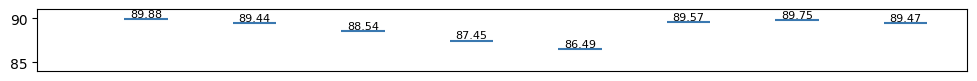

In [19]:
date_order_num = range(len(date_order))
plt.figure(figsize=(12, 0.8)) 
for x, y in zip(date_order_num, accuracy_order):
    if x != 0:
        plt.hlines(y=y, xmin=x - 0.2, xmax=x + 0.2, colors='#3a78b0')  
        plt.text(x, y + 0.01, f'{y:.2f}', ha='center', va='bottom', fontsize=8) 

plt.xticks(range(len(date_order_num)), date_order_num, rotation=45, ha='right') 
plt.yticks(fontsize=10)
plt.ylim(84, 91)
plt.xticks([])

plt.savefig('accuracy_plot.pdf', bbox_inches='tight', format='pdf')
plt.show()

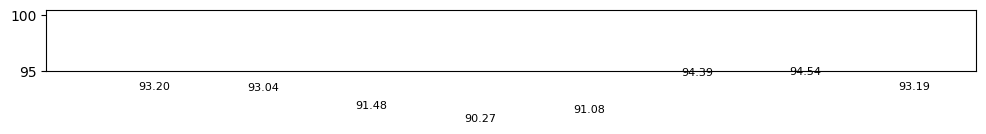

In [20]:
date_order_num = range(len(date_order))
plt.figure(figsize=(12, 0.8)) 
for x, y in zip(date_order_num, tnr_order):
    if x != 0:
        plt.hlines(y=y, xmin=x - 0.2, xmax=x + 0.2, colors='#3a78b0')  
        plt.text(x, y + 0.01, f'{y:.2f}', ha='center', va='bottom', fontsize=8) 

plt.xticks(range(len(date_order_num)), date_order_num, rotation=45, ha='right') 
plt.yticks(fontsize=10)
plt.ylim(95, 100.5)
plt.xticks([])

plt.savefig('tnr_plot.pdf', bbox_inches='tight', format='pdf')
plt.show()

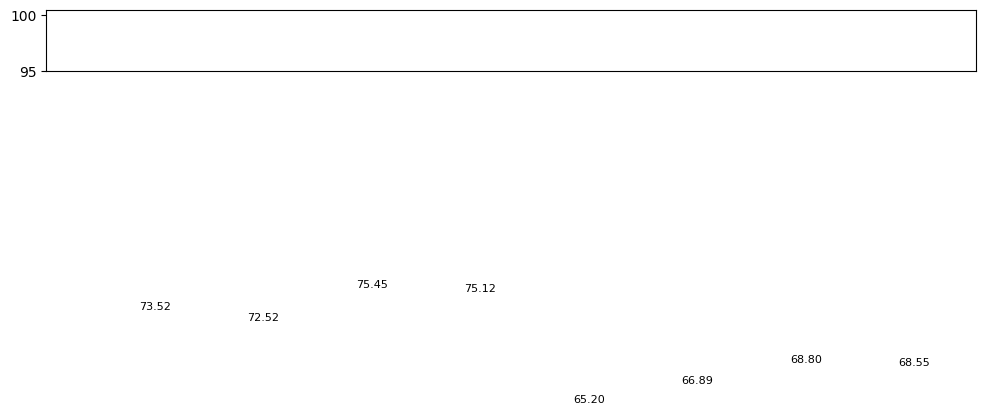

In [21]:
date_order_num = range(len(date_order))
plt.figure(figsize=(12, 0.8)) 
for x, y in zip(date_order_num, tpr_order):
    if x != 0:
        plt.hlines(y=y, xmin=x - 0.2, xmax=x + 0.2, colors='#3a78b0')  
        plt.text(x, y + 0.01, f'{y:.2f}', ha='center', va='bottom', fontsize=8) 

plt.xticks(range(len(date_order_num)), date_order_num, rotation=45, ha='right') 
plt.yticks(fontsize=10)
plt.ylim(95, 100.5)
plt.xticks([])

plt.savefig('tpr_plot.pdf', bbox_inches='tight', format='pdf')
plt.show()